# Visualizing Initial Predictions

We want to plot a heatmap of detection locations.
This notebook is to try different settings for visualizations for a test.

In [204]:
import pandas as pd
import numpy as np

from bokeh.plotting import figure, show, output_file
from bokeh.models import ColumnDataSource, HoverTool

In [205]:
df = pd.read_csv('/Users/wfu/Desktop/resnet101_night.csv')

In [206]:
df

,Unnamed: 0,timestamp,frame,bboxes,scores,classes,COM
0,0,2019-05-04 00:13:28.995418,0,[[0.579453 0.46526062 0.97456646 0.85218906]...,[0.883732 0.81502134 0.72130114 0.617881 0...,[8. 1. 1. 1. 1. 1. 1. 3. 1. 6. 1. 9. 3. 1. 1. ...,[0.20677586 0.44839561]
1,1,2019-05-04 00:13:28.995418,1,[[0.5742204 0.4671075 0.9724437 0.8479903 ]...,[0.89794916 0.8931978 0.8552668 0.69191396 0...,[8. 3. 1. 1. 1. 6. 3. 1. 9. 1. 1. 1. 1. 1. 1. ...,[0. 0.]
2,2,2019-05-04 00:13:28.995418,2,[[0.50907314 0.6100915 0.59229493 0.63992184]...,[0.90658975 0.891791 0.88819593 0.8764702 0...,[1. 8. 3. 1. 1. 1. 1. 1. 6. 9. 3. 1. 1. 1. 1. ...,[0. 0.]
3,3,2019-05-04 00:13:28.995418,3,[[0.36118126 0.13444355 0.50981534 0.20953721]...,[0.9411758 0.8617308 0.8345422 0.72619677 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 3. 9. 1. 1. 1. 1. ...,[0. 0.]
4,4,2019-05-04 00:13:28.995418,4,[[0.3604128 0.13319428 0.5107636 0.20899113]...,[0.94357795 0.8978639 0.84952027 0.82104975 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 3. 1. 9. 1. 1. 1. ...,[0. 0.]
5,5,2019-05-04 00:13:28.995418,5,[[0.36186624 0.13354284 0.51203966 0.21109062]...,[0.96791124 0.8592276 0.8379158 0.6573467 0...,[3. 8. 1. 1. 1. 1. 1. 1. 6. 3. 1. 9. 1. 1. 1. ...,[0. 0.]
6,6,2019-05-04 00:13:28.995418,6,[[0.3638824 0.1345322 0.5138297 0.21128555]...,[0.9680963 0.85675216 0.8452743 0.62403 0...,[3. 8. 1. 1. 8. 1. 1. 9. 1. 6. 1. 3. 1. 1. 1. ...,[0. 0.]
7,7,2019-05-04 00:13:28.995418,7,[[0.37598994 0.13353914 0.5216516 0.20926061]...,[0.954439 0.83861583 0.7286515 0.68554366 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 8. 9. 6. 1. 1. 1. ...,[0. 0.]
8,8,2019-05-04 00:13:28.995418,8,[[0.374226 0.13339856 0.5194447 0.21042773]...,[0.94655895 0.840181 0.6605432 0.5319587 0...,[3. 8. 1. 1. 1. 6. 1. 1. 1. 9. 1. 1. 1. 1. 1. ...,[0. 0.]
9,9,2019-05-04 00:13:28.995418,9,[[0.37938055 0.13214988 0.5265699 0.21294454]...,[0.94152623 0.85209155 0.8246738 0.6398536 0...,[3. 1. 8. 1. 1. 1. 1. 6. 8. 1. 1. 1. 1. 1. 1. ...,[0.68463004 0.57864869]


Com means center of mass

In [4]:
com = [x.strip().replace('[', '').replace(']', '').split(' ') for x in list(df.COM)]

def convert_to_float(lst):
    new_lst = []
    for x in lst:
        try:
            new_lst.append(float(x))
        except ValueError:
            pass
    return new_lst

com = list(map(convert_to_float, com))
com_x = [x[0] for x in com]
com_y = [x[1] for x in com]
df["com_x"] = com_x
df["com_y"] = com_y

In [5]:
df

,Unnamed: 0,timestamp,frame,bboxes,scores,classes,COM,com_x,com_y
0,0,2019-05-04 00:13:28.995418,0,[[0.579453 0.46526062 0.97456646 0.85218906]...,[0.883732 0.81502134 0.72130114 0.617881 0...,[8. 1. 1. 1. 1. 1. 1. 3. 1. 6. 1. 9. 3. 1. 1. ...,[0.20677586 0.44839561],0.206776,0.448396
1,1,2019-05-04 00:13:28.995418,1,[[0.5742204 0.4671075 0.9724437 0.8479903 ]...,[0.89794916 0.8931978 0.8552668 0.69191396 0...,[8. 3. 1. 1. 1. 6. 3. 1. 9. 1. 1. 1. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
2,2,2019-05-04 00:13:28.995418,2,[[0.50907314 0.6100915 0.59229493 0.63992184]...,[0.90658975 0.891791 0.88819593 0.8764702 0...,[1. 8. 3. 1. 1. 1. 1. 1. 6. 9. 3. 1. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
3,3,2019-05-04 00:13:28.995418,3,[[0.36118126 0.13444355 0.50981534 0.20953721]...,[0.9411758 0.8617308 0.8345422 0.72619677 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 3. 9. 1. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
4,4,2019-05-04 00:13:28.995418,4,[[0.3604128 0.13319428 0.5107636 0.20899113]...,[0.94357795 0.8978639 0.84952027 0.82104975 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 3. 1. 9. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
5,5,2019-05-04 00:13:28.995418,5,[[0.36186624 0.13354284 0.51203966 0.21109062]...,[0.96791124 0.8592276 0.8379158 0.6573467 0...,[3. 8. 1. 1. 1. 1. 1. 1. 6. 3. 1. 9. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
6,6,2019-05-04 00:13:28.995418,6,[[0.3638824 0.1345322 0.5138297 0.21128555]...,[0.9680963 0.85675216 0.8452743 0.62403 0...,[3. 8. 1. 1. 8. 1. 1. 9. 1. 6. 1. 3. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
7,7,2019-05-04 00:13:28.995418,7,[[0.37598994 0.13353914 0.5216516 0.20926061]...,[0.954439 0.83861583 0.7286515 0.68554366 0...,[3. 8. 1. 1. 1. 1. 1. 1. 1. 8. 9. 6. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
8,8,2019-05-04 00:13:28.995418,8,[[0.374226 0.13339856 0.5194447 0.21042773]...,[0.94655895 0.840181 0.6605432 0.5319587 0...,[3. 8. 1. 1. 1. 6. 1. 1. 1. 9. 1. 1. 1. 1. 1. ...,[0. 0.],0.000000,0.000000
9,9,2019-05-04 00:13:28.995418,9,[[0.37938055 0.13214988 0.5265699 0.21294454]...,[0.94152623 0.85209155 0.8246738 0.6398536 0...,[3. 1. 8. 1. 1. 1. 1. 6. 8. 1. 1. 1. 1. 1. 1. ...,[0.68463004 0.57864869],0.684630,0.578649


Let's make a scaled version of our locations, so it matches the aspect ratio of the video.
This way we can overlay the points on the video to see the detection heatmap.

In [18]:
HEIGHT = 360
WIDTH = 640

In [31]:
p = figure(title = "Iris Morphology",
    plot_height=500, 
    plot_width=500,
    match_aspect=True)
    #tools=[hover, "pan,reset,wheel_zoom"])

df["scaled_x"] = df.com_x * WIDTH
df["scaled_y"] = df.com_y * HEIGHT

p.circle(
    'scaled_x',
    'scaled_y',
    fill_alpha=0.2, size=10, source=ColumnDataSource(df))

GlyphRenderer(id='2268', ...)

In [32]:
q = figure(title = "Iris Morphology",
    plot_height=500, 
    plot_width=500)
    #tools=[hover, "pan, reset, wheel_zoom"])
    
q.circle(np.random.uniform(0, 1, 100),
         np.random.uniform(0, 2, 100),
         fill_alpha=0.2, size=10)

GlyphRenderer(id='2309', ...)

In [33]:
# Bokeh Library
from bokeh.io import output_file, output_notebook
from bokeh.models.widgets import Tabs, Panel
from bokeh.plotting import show

# Output to file
output_notebook()

fig = figure(title='My Tutorial Progress',
             plot_height=400, plot_width=700,
             x_axis_label='Day Number', y_axis_label='Words Written',
             x_minor_ticks=2, y_range=(0, 6000),
             toolbar_location=None)

# Increase the plot widths
# east_fig.plot_width = west_fig.plot_width = 800

# Create two panels, one for each conference
east_panel = Panel(child=p, title='Our Locations')
west_panel = Panel(child=q, title='Random')

# Assign the panels to Tabs
tabs = Tabs(tabs=[west_panel, east_panel])

# Show the tabbed layout
show(tabs)

Loading BokehJS ...

In [38]:
len(com)

3200

In [53]:
centers_of_mass = np.array(com) * np.array([WIDTH, HEIGHT])
centers_of_mass = centers_of_mass[centers_of_mass.sum(axis=1) > 0]

centers_of_mass_x = centers_of_mass[:, 0]
centers_of_mass_y = centers_of_mass[:, 1]

In [54]:
import numpy as np
from bokeh.io import output_file, show
from bokeh.plotting import figure
from bokeh.transform import linear_cmap
from bokeh.util.hex import hexbin

In [67]:
# Output to file
output_notebook()

bins = hexbin(centers_of_mass_x,
              centers_of_mass_y,
              9)

p = figure(title="Testing", tools="wheel_zoom,pan,reset",
           match_aspect=True, background_fill_color='#440154')
p.grid.visible = False

p.hex_tile(q="q", r="r", size=0.1, line_color=None, source=bins,
           # fill_color=linear_cmap('counts', 'Viridis256', 0, max(bins.counts)))
           fill_color=linear_cmap('counts', 'Viridis256', 0, max(bins.counts)))

# Show the tabbed layout
show(p)

Loading BokehJS ...

In [175]:
from matplotlib import pyplot as plt
import matplotlib
import cv2
%matplotlib inline

# Make the color stuff with alpha on top of it
import copy
red_alpha = copy.copy(matplotlib.cm.Reds)
blue_alpha = copy.copy(matplotlib.cm.Blues)
green_alpha = copy.copy(matplotlib.cm.Greens)
red_alpha._init()
blue_alpha._init()
green_alpha._init()
red_alpha._lut[0,3] = 0
blue_alpha._lut[0,3] = 0
green_alpha._lut[0,3] = 0

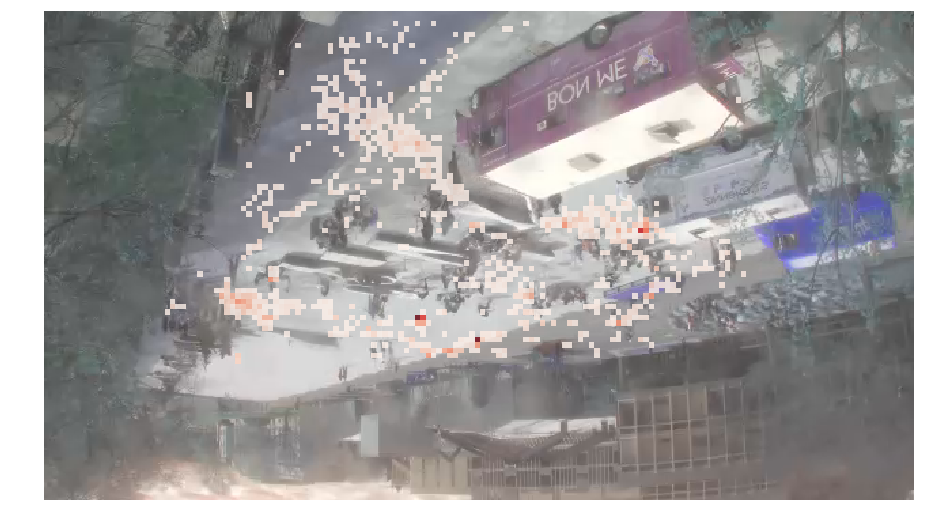

In [203]:
fig, ax = plt.subplots(figsize=(16, 9))
image = cv2.imread("/Users/wfu/Desktop/llorente.png")
ax.imshow(image, origin='lower')

# Make the color stuff with alpha on top of it
import copy
red_alpha = copy.copy(matplotlib.cm.Reds)
blue_alpha = copy.copy(matplotlib.cm.Blues)
green_alpha = copy.copy(matplotlib.cm.Greens)
red_alpha._init()
blue_alpha._init()
green_alpha._init()
red_alpha._lut[0,3] = 0
blue_alpha._lut[0,3] = 0
green_alpha._lut[0,3] = 0

picture_range = np.array([[0, WIDTH], [0, HEIGHT]])
ax.hist2d(centers_of_mass_x, centers_of_mass_y, bins=(160, 90),
             range=picture_range, cmap=red_alpha, alpha=0.8)
plt.axis('equal')
plt.axis('off')
plt.xlim(0, 640)
plt.ylim(0, 360)

plt.show()

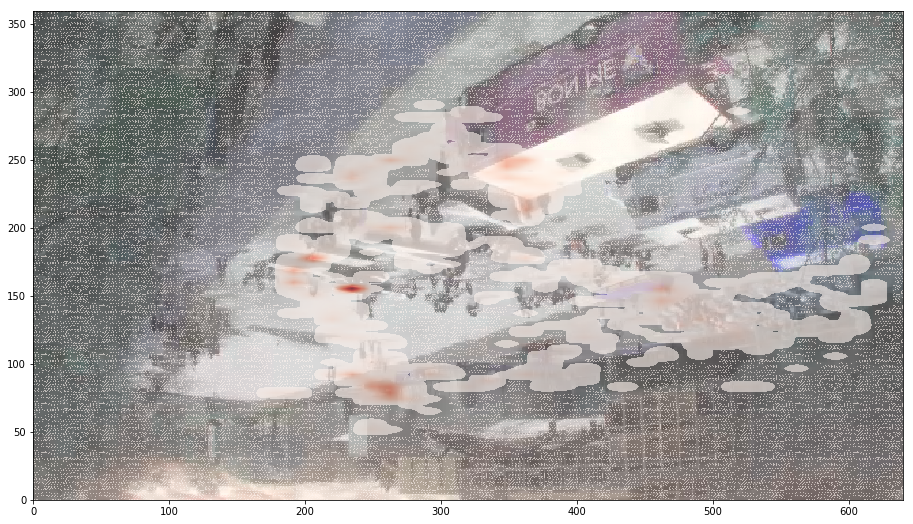

In [199]:
fig, ax = plt.subplots(figsize=(16, 9))
image = cv2.imread("/Users/wfu/Desktop/llorente.png")

plt.imshow(image)


picture_range = np.array([[0, WIDTH], [0, HEIGHT]])
h, x, y, p = ax.hist2d(centers_of_mass_x, centers_of_mass_y, bins=(80, 45),
             range=picture_range, cmap=red_alpha, alpha=0)
plt.imshow(h, origin='lower', interpolation="bilinear", extent=[0, 640, 0, 360], alpha=0.6, cmap=red_alpha)
# plt.axis('equal')
# plt.axis('off')
# ax = plt.gca()
# ax.set_ylim(ax.get_ylim()[::-1])
plt.xlim(0, 640)
plt.ylim(0, 360)

plt.show()